In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import pickle
import collections
from models.e2cnn_models import TableModel
from dataloaders.annotated_sphaera import annotated_sphaera_tables
from evaluation.full_annotations import PeakDigitsEachChannel
from plotting.plot import plot_layers
from table_utils import *

## A. Detecting Bigrams: Sacrobosco Tables Dataset

In [2]:
# Define model configs
weightfile="data/trained_model/table_model.pt"
modeljobfile="data/trained_model/jobdict.p"

scales = [1.]
extra_bias = 10.
shift = [8,10]
numbers = [(i,) for i in range(10)] + [(0,i) for i in range(10)] + [(int(str(i)[0]), int(str(i)[1])) for i in range(10,100)]

peak_params = {'scale_isolated': 3,
     'max_d': 15,
     'peak_cutoff_rel': 0.12,
     'clip_cutoff': 0.,
     'verbose': False}

PD = PeakDigitsEachChannel(**peak_params)

# Load model
model_jobdict = pickle.load(open(modeljobfile, 'rb'))

mdict = model_jobdict[7]
mdict['clip_max'] = None
mdict['invariance_rots'] = [0] 
print(mdict)
dict_ =  {k:v for k,v in torch.load(weightfile).items() if k not in ['smoothing.weight']}

model = TableModel(**mdict)
model.load_state_dict(dict_)
_ = model.eval()
_ = model.cuda()

{'kernel_sizes': [3, 3, 5, 5, 5, 1, 1], 'paddings': [1, 1, 2, 2, 2, 0, 0], 'kernels': ['r_16', 'r_16', 'r_32', 'r_64', 'c_64', 'c_32', 'c_10'], 'N': 8, 'final_bias': 0.1, 'invariance_rots': [0], 'clip_max': None}


/usr/local/lib/python3.10/site-packages/e2cnn/nn/modules/r2_conv/basisexpansion_singleblock.py:80: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at ../aten/src/ATen/native/IndexingUtils.h:27.)
  full_mask[mask] = norms.to(torch.uint8)


/usr/local/lib/python3.10/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


use max_d for clustering 15


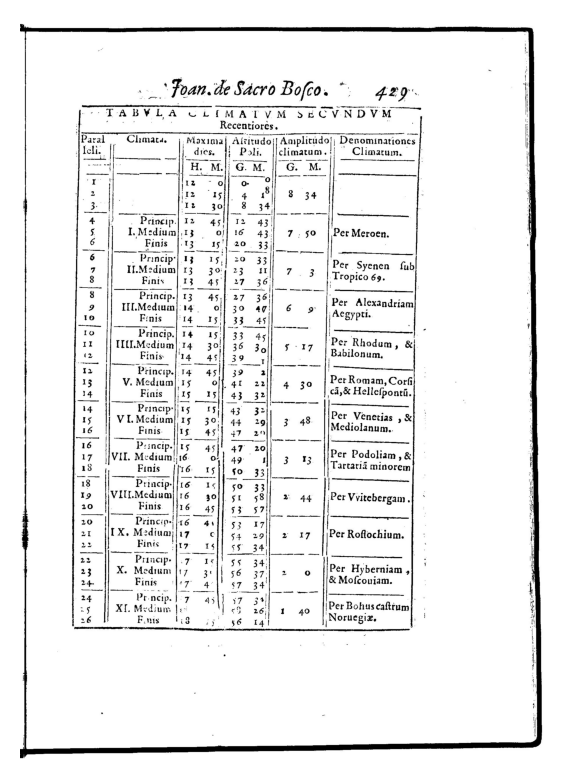

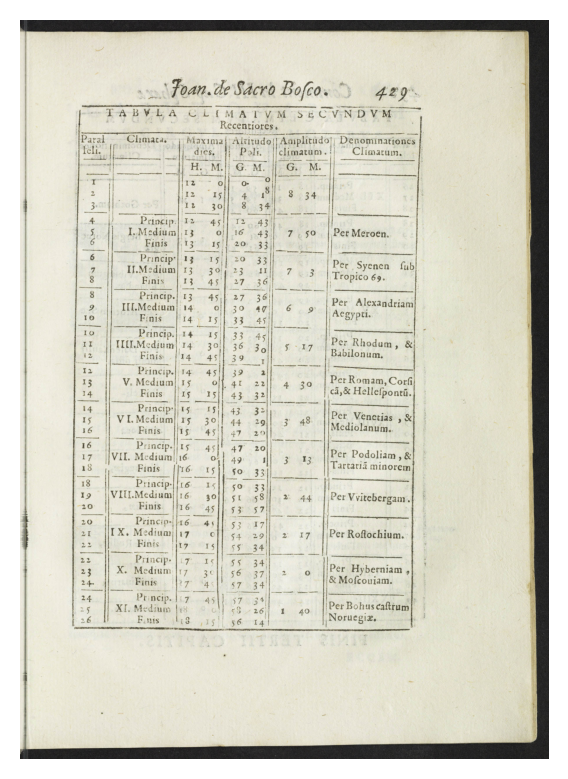

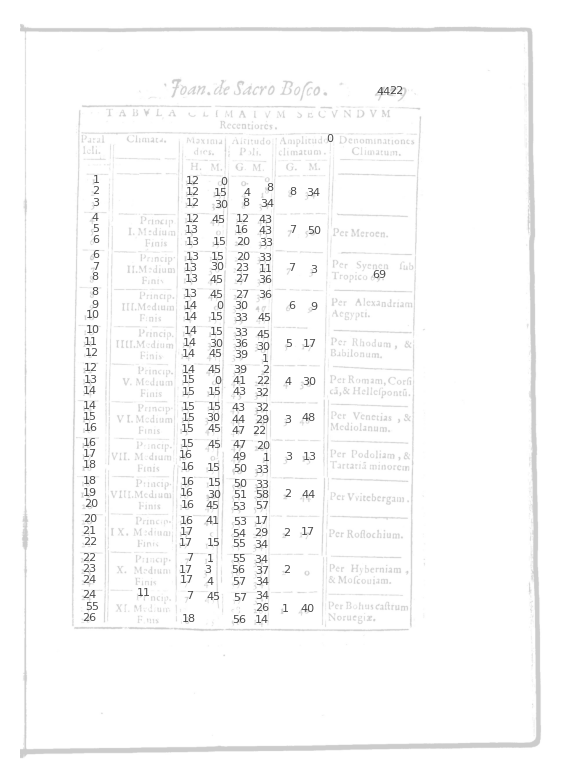

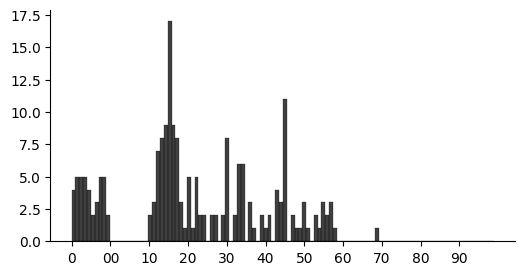

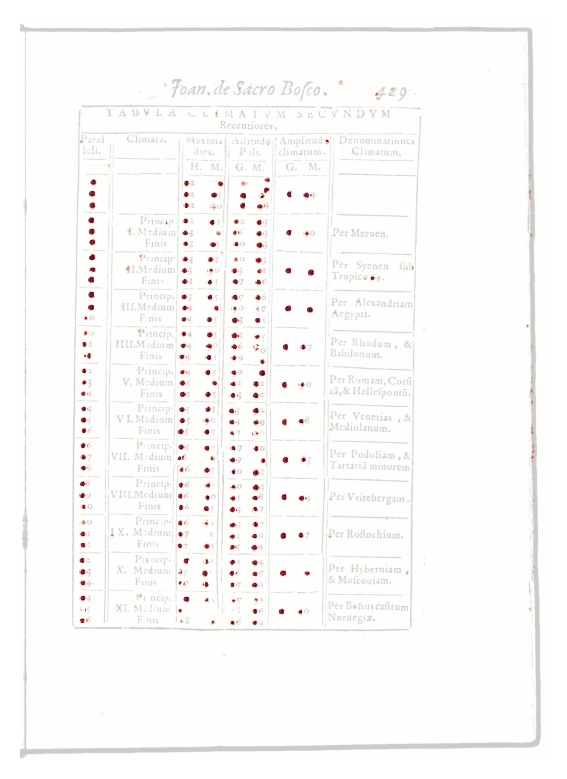

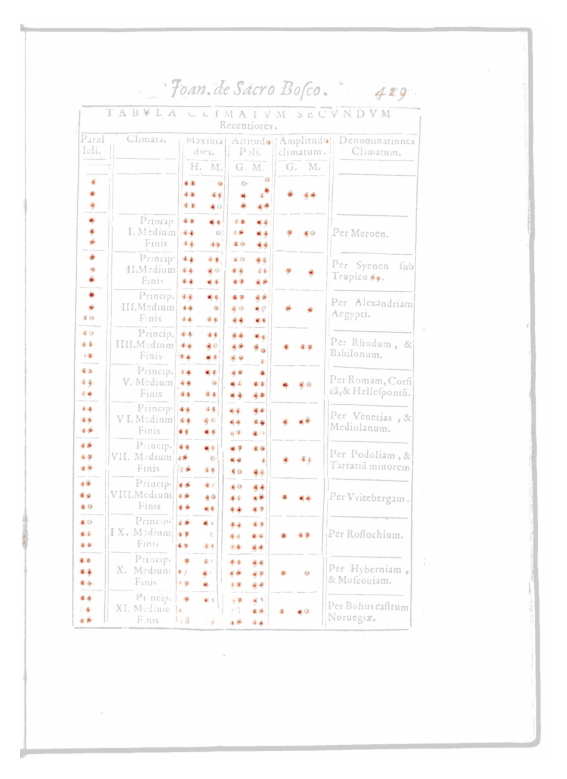

In [3]:
from dataloaders.sphaera_tables import sphaera_tables

# Select one example page

ref_pages = ['data/example_corpus/sacrobosco_tables/processed/808_clavius_sphaera_1585_p465.jpg',
            # 'data/example_corpus/sacrobosco_tables/processed/1921_pifferi_sfera_1604_p368.jpg'
            ]

dataloader = sphaera_tables(None, ref_pages,  refsize=1200)

for x in dataloader:
    page, page_source = x
    pages = [page.cuda()]
    
    H, H_grams, _ = model.compute_forward_scales(pages, 
                                numbers, 
                                shift,
                                remove_mean=False,
                                scale_sizes = [int(1200*scale) for scale in scales],
                                scales = scales)   
        
    H_single = H.detach().cpu().squeeze().numpy()
    H_grams = np.array([h.detach().cpu().numpy().squeeze() for h in H_grams])
    X_in = pages[0].detach().cpu().squeeze().numpy()
    
    # Filter background noise
    H_out = np.clip(H_grams - extra_bias, a_min=0, a_max = None)
    
    # Peak Detection to extract digits
    input_data = {'X_scale': pages[0],
                 'H_all_comps': H_grams,
                 'rot_chosen': model.chosen_params[1]}


    hist_out_peaks, bigrams_final, bigram_map, img = PD.proc(input_data)
    peaks_counts = collections.Counter(hist_out_peaks)
    pd_hist = [peaks_counts[j] if j in peaks_counts else 0 for j in range(len(numbers))]

    ref_page = page_source
    
    res_dict = {'img': X_in, 
                'hist': pd_hist , 
                'pdigit': bigrams_final, 
                'H_single': H_single,
                'H_grams': H_out}
    
    plot_layers(ref_page, res_dict, plot_dir=None)

        

## B. Information Retrieval - Sphaera Table Corpus

In [4]:
from table_utils import get_data
res_pfile='data/inference/sphaera_hists.p'

# Make sure to have the full Sacrobosco Tables Corpus locally (see README for details and modify SACROBOSCO_DATA_ROOT).
from configs import SACROBOSCO_DATA_ROOT

H, M = get_data(res_pfile, file_map = SACROBOSCO_DATA_ROOT)
all_pages, years, books, books_unique,  book_dict = get_meta(M)

/home/space/sphaera/sphaera_tables/processed/1818_clavius_sphaeram_1608_p217.jpg


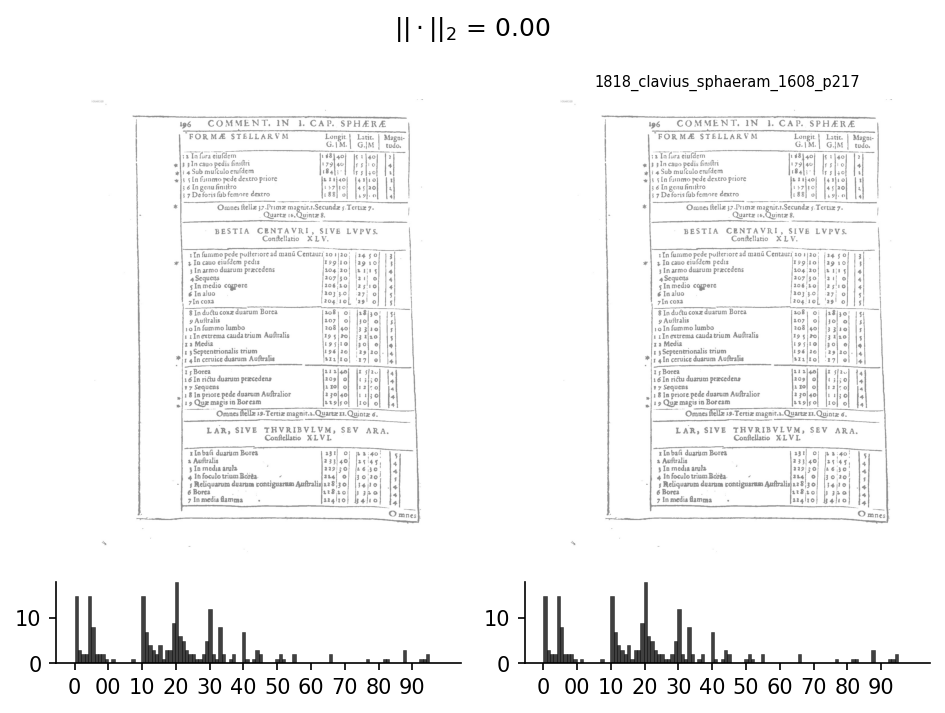

/home/space/sphaera/sphaera_tables/processed/1817_clavius_sphaeram_1607_p242.jpg


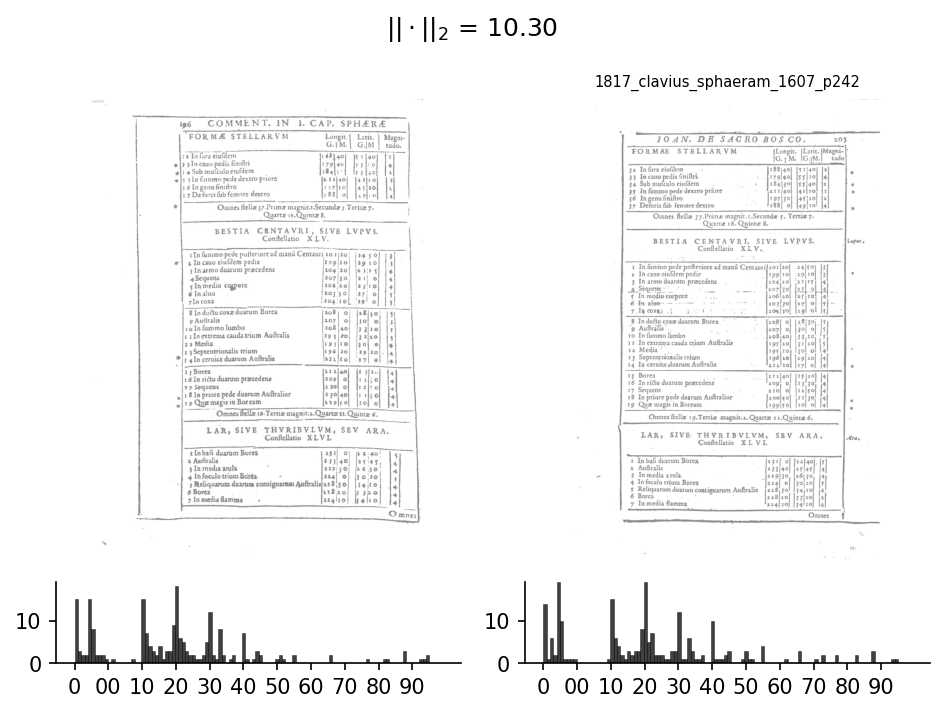

/home/space/sphaera/sphaera_tables/processed/1755_clavius_commentarius_1607_p210.jpg


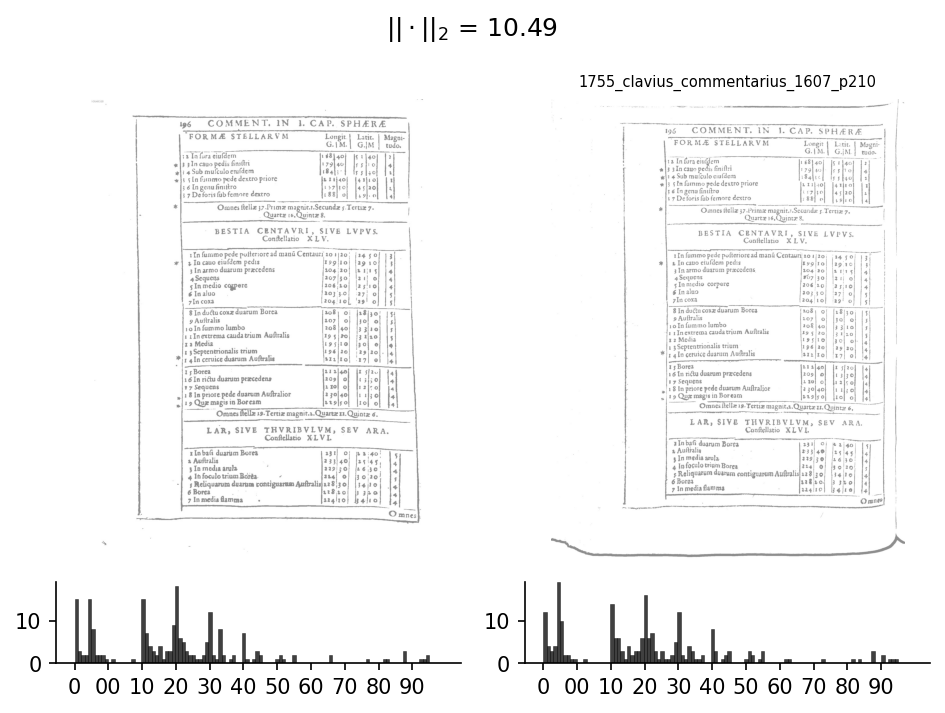

In [5]:
import scipy
from plotting.plot import plot_hist
from matplotlib import gridspec

def find_similar(x_ref, X, topn=3, func=scipy.spatial.distance.cdist, kwargs ={}):
    dists = func(x_ref, X, **kwargs).squeeze()
    inds = np.argsort(dists)
    vals = list(zip(inds,dists[inds]))
    return vals[:topn]


query_idx = 1390

if query_idx is None:
    # Specify histogram to query for
    h_query = np.ones((1,110))
    im_query = np.zeros((10,8))  
else:
    # Use a page from the sphaera corpus as query
    h_query = H[query_idx][np.newaxis,:]
    im_query =load_image(M[query_idx])
    
    
top_keys = find_similar(h_query, H, topn=3,  kwargs={'metric':'euclidean'})

for ind, dist in top_keys:
    m = M[ind]
    hist = H[ind]
    page_name = all_pages[ind][0]

    print(m)
    image = load_image(m, gray=False)
    
    f = plt.figure(dpi=150)
    gs = gridspec.GridSpec(2,2, width_ratios=[0.5, 0.5], height_ratios=[0.85,0.15]) 
    
    for i,im_,h_, str_ in zip([0,1], [im_query,image],[h_query, hist],  ['',page_name]):
    
        ax = plt.subplot(gs[i])
        ax.imshow(im_ , cmap='Greys', alpha=0.45)
        ax.axis('off')
        ax.set_title(str_, fontsize=7)

        ax = plt.subplot(gs[i+2])
        plot_hist(ax, h_.squeeze())
        ax.set_ylim([0,np.max([h_query.squeeze(),hist])])

    f.suptitle(r'$||\cdot||_2$ = {:0.2f}'.format(dist))     
    f.tight_layout()
    plt.show()

# C. Clustering

359
('1594_beyer_quaestiones_1550_p184', '/home/space/sphaera/sphaera_tables/processed/1594_beyer_quaestiones_1550_p184.jpg')


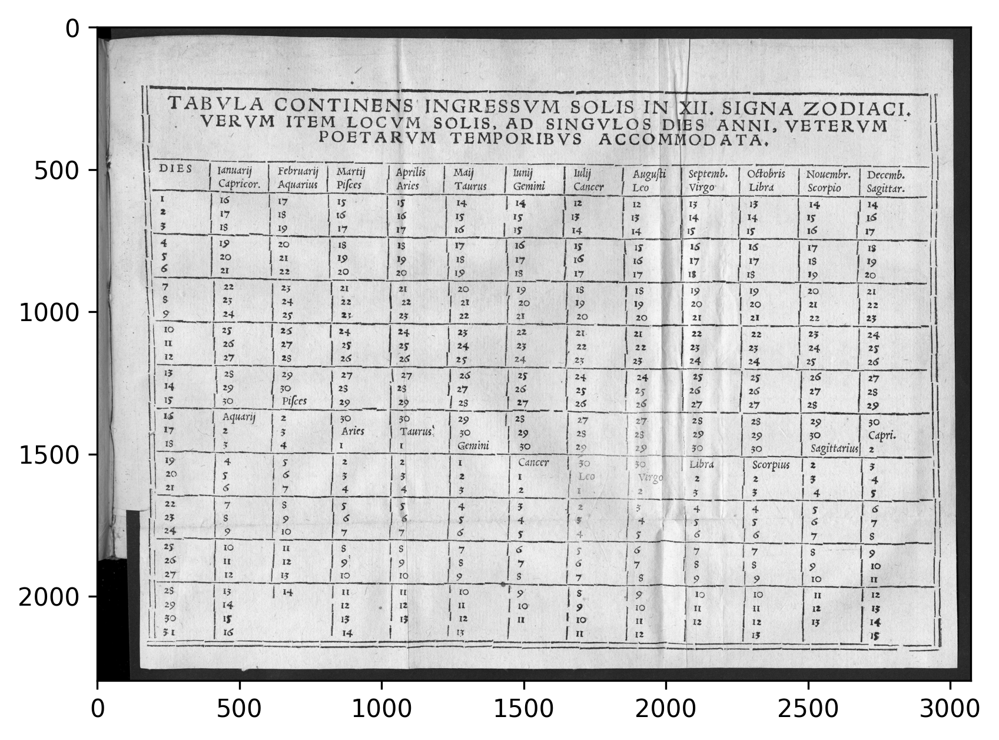

('1888_melanchthon_libellus_1543_p246', '/home/space/sphaera/sphaera_tables/processed/1888_melanchthon_libellus_1543_p246.jpg')


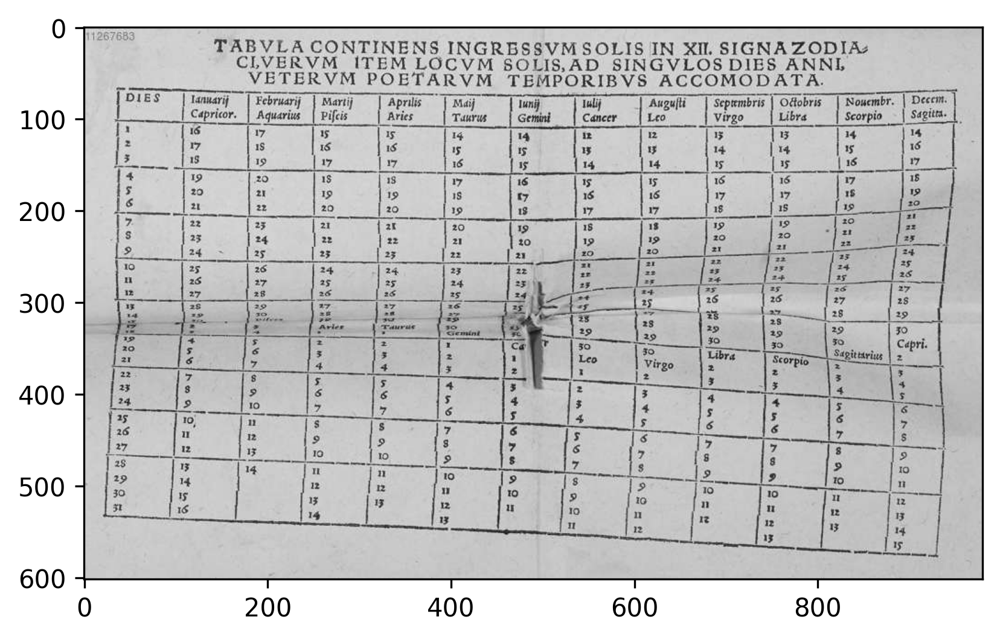

('1899_melanchthon_libellus_1629_p248', '/home/space/sphaera/sphaera_tables/processed/1899_melanchthon_libellus_1629_p248.jpg')


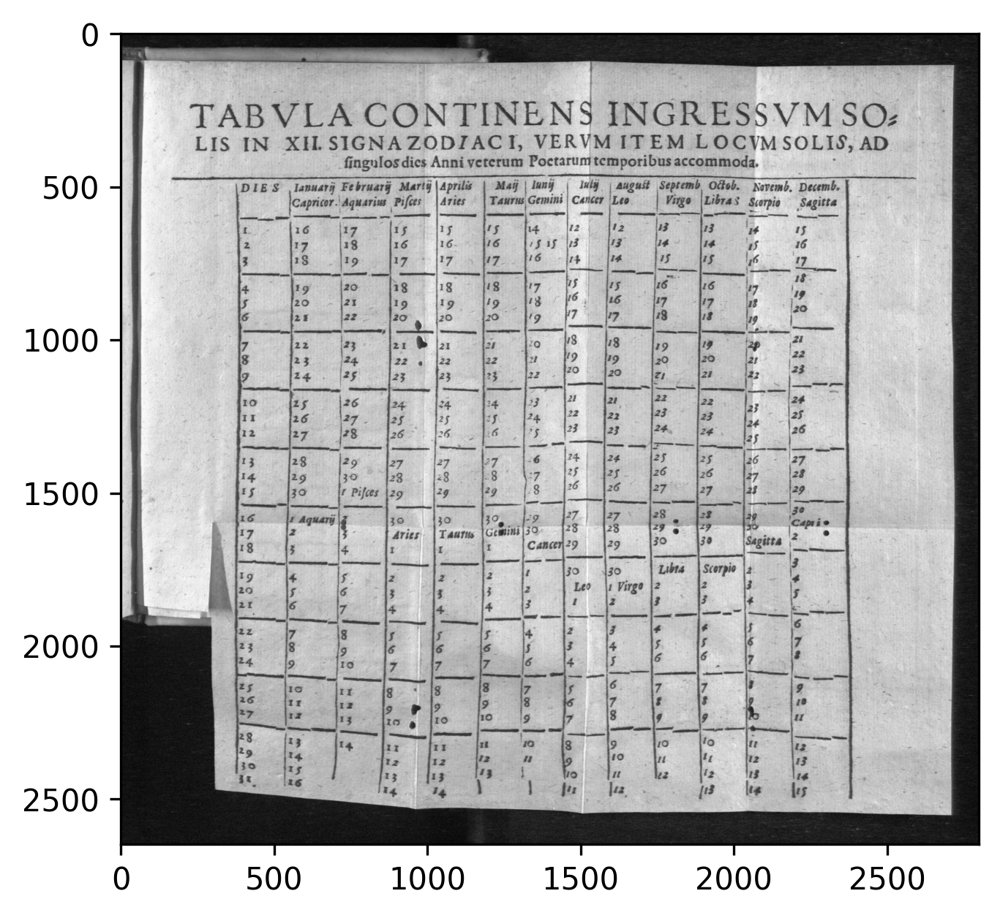

('1896_sacrobosco_libellus_1568_p117', '/home/space/sphaera/sphaera_tables/processed/1896_sacrobosco_libellus_1568_p117.jpg')


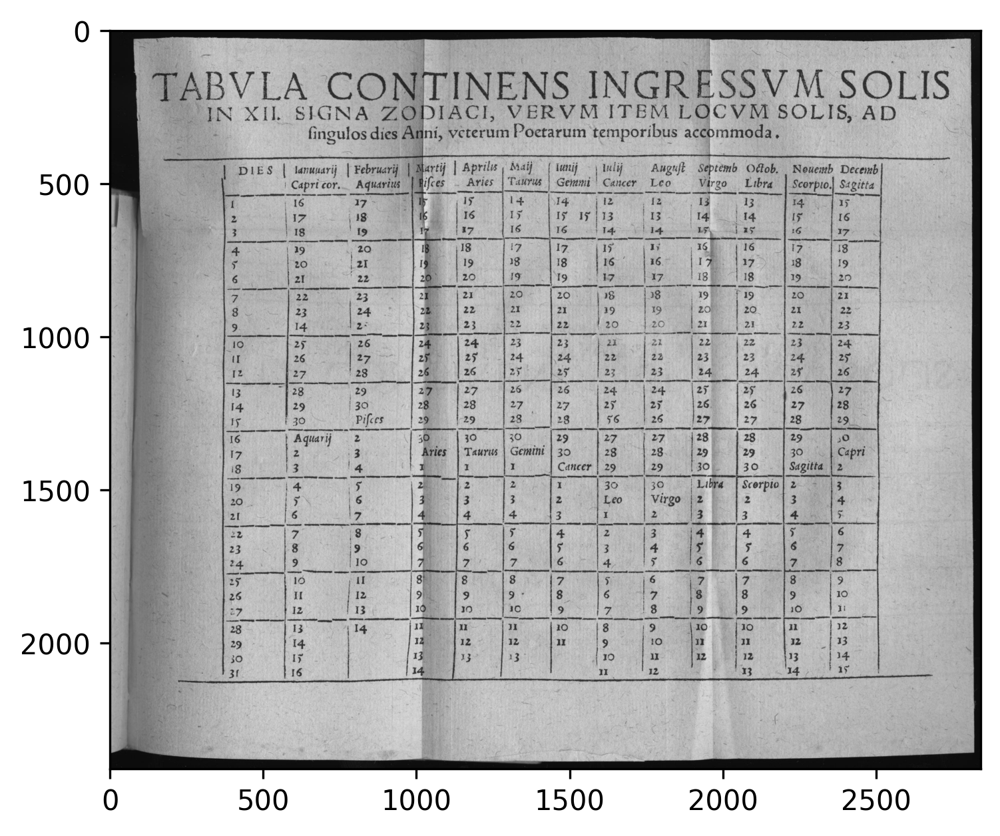

('1898_melanchthon_libellus_1578_p283', '/home/space/sphaera/sphaera_tables/processed/1898_melanchthon_libellus_1578_p283.jpg')


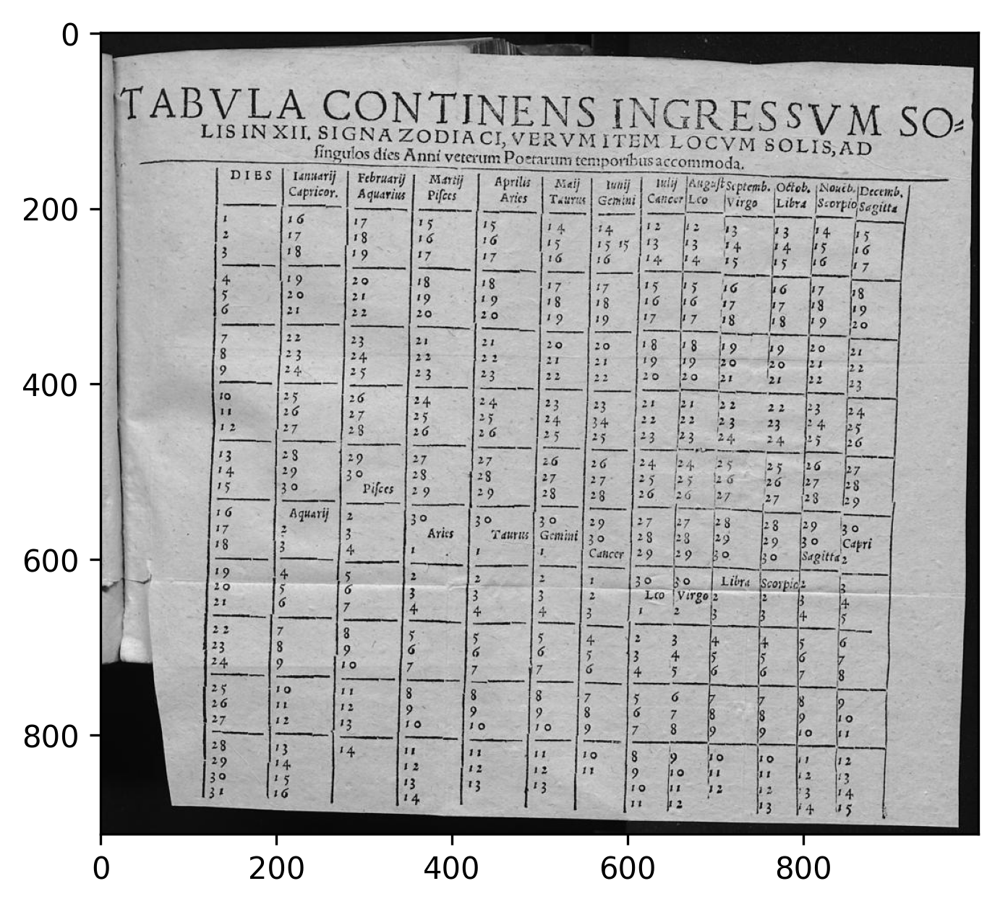

('1962_vinet_sphaera_1619_p75', '/home/space/sphaera/sphaera_tables/processed/1962_vinet_sphaera_1619_p75.jpg')


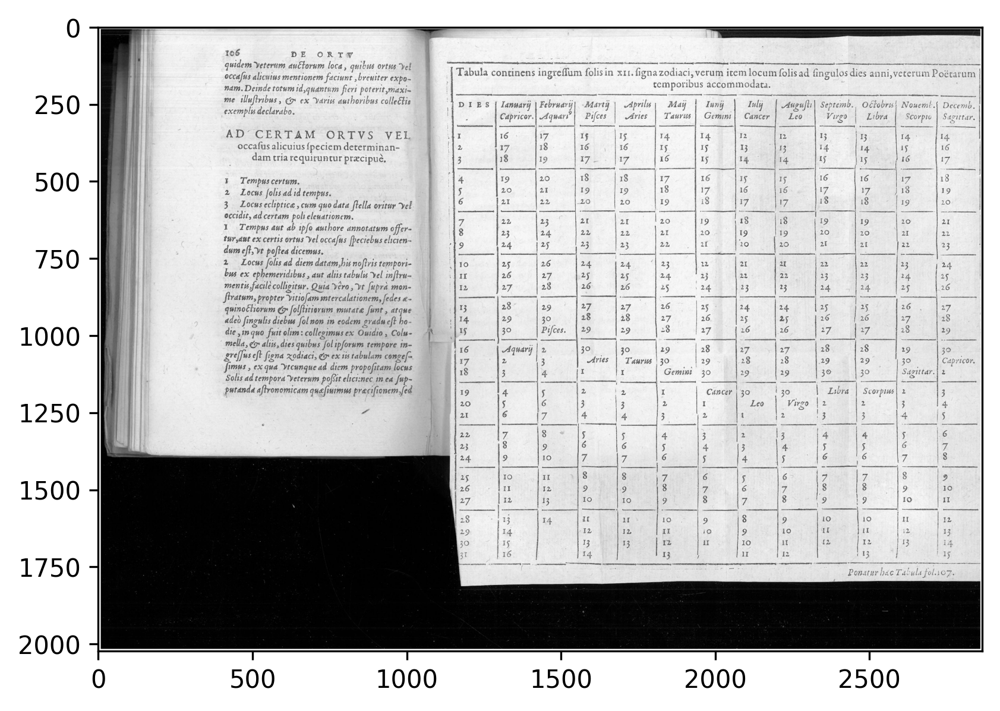

('2168_peucer_elementa_1558_p198', '/home/space/sphaera/sphaera_tables/processed/2168_peucer_elementa_1558_p198.jpg')


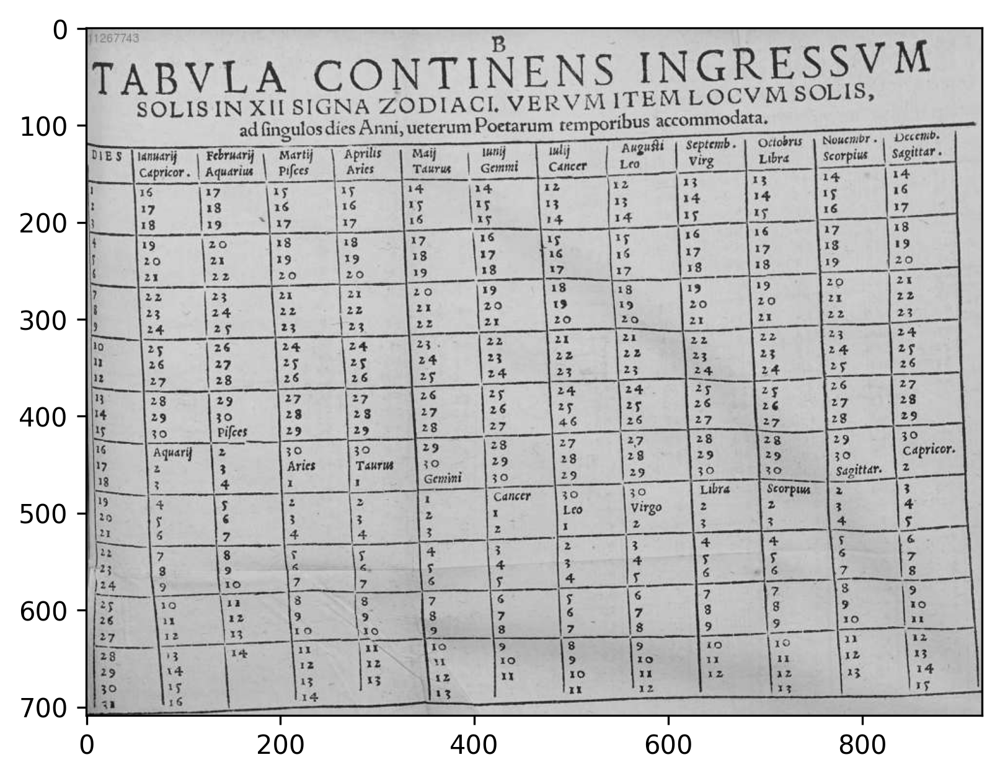

('2169_peucer_elementa_1576_p196', '/home/space/sphaera/sphaera_tables/processed/2169_peucer_elementa_1576_p196.jpg')


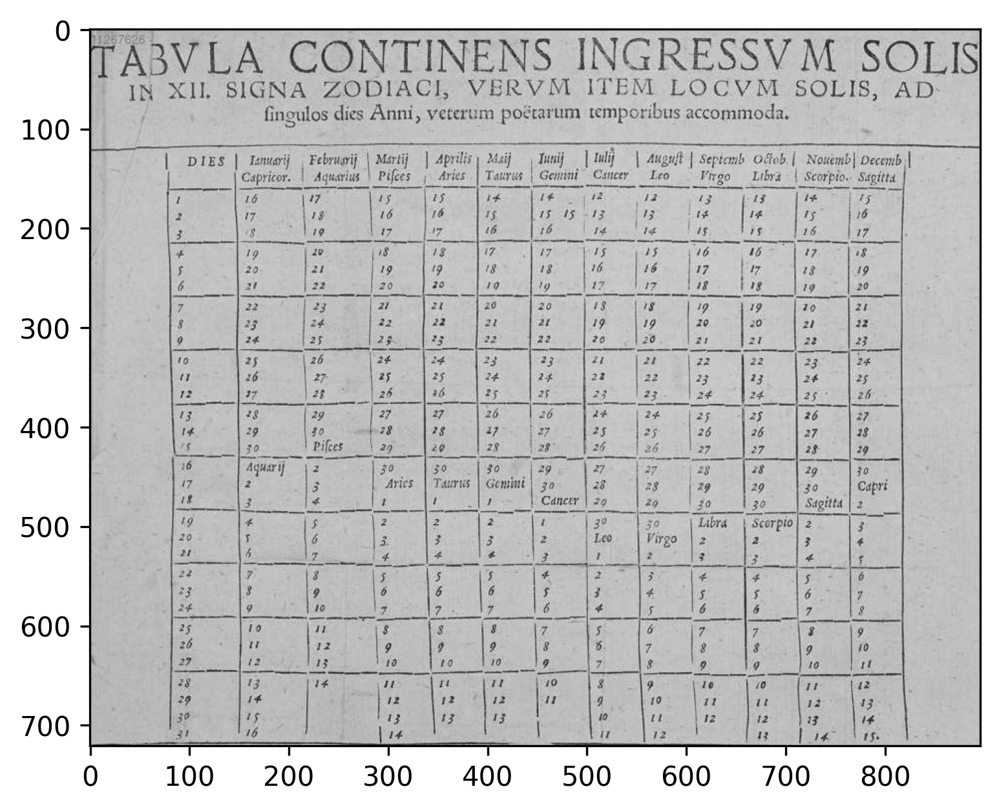

('2173_peucer_elementa_1601_p197', '/home/space/sphaera/sphaera_tables/processed/2173_peucer_elementa_1601_p197.jpg')


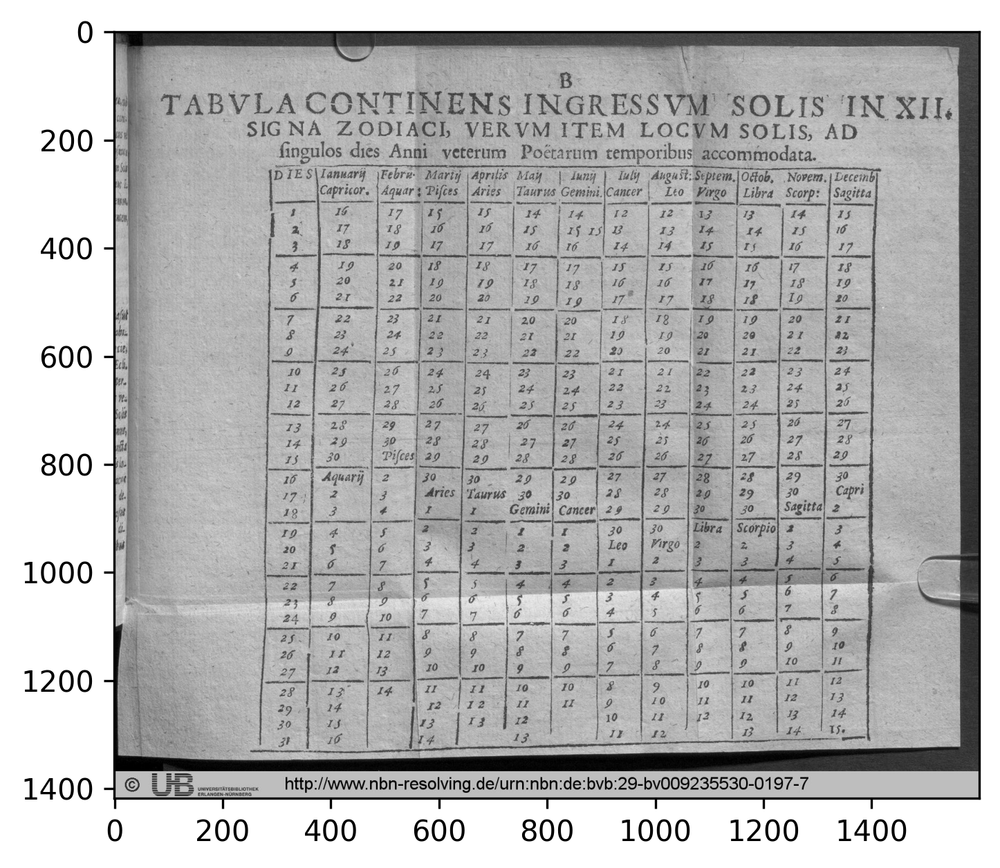

('2190_giuntini_speculum_1583_p772', '/home/space/sphaera/sphaera_tables/processed/2190_giuntini_speculum_1583_p772.jpg')


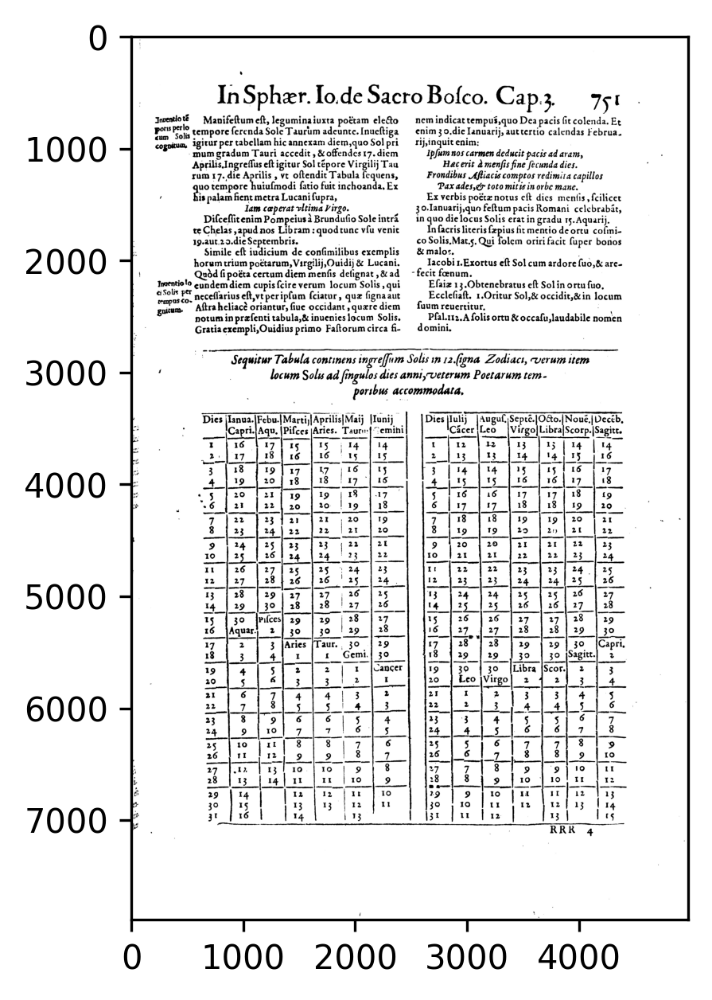

('2258_giuntini_speculum_1581_p761', '/home/space/sphaera/sphaera_tables/processed/2258_giuntini_speculum_1581_p761.jpg')


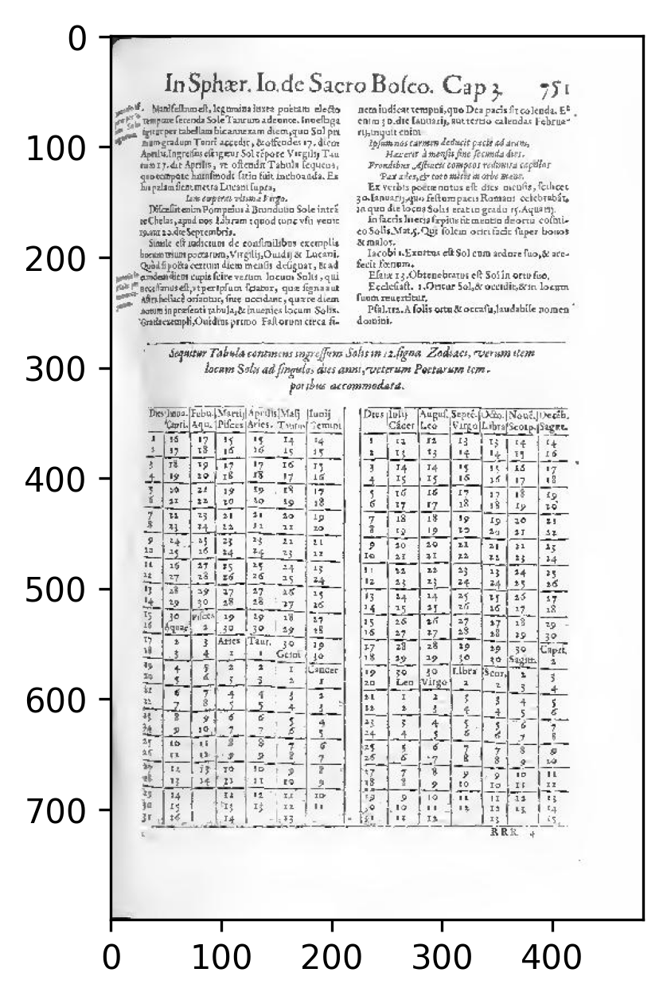

('2271_blebel_libellus_1577_p169', '/home/space/sphaera/sphaera_tables/processed/2271_blebel_libellus_1577_p169.jpg')


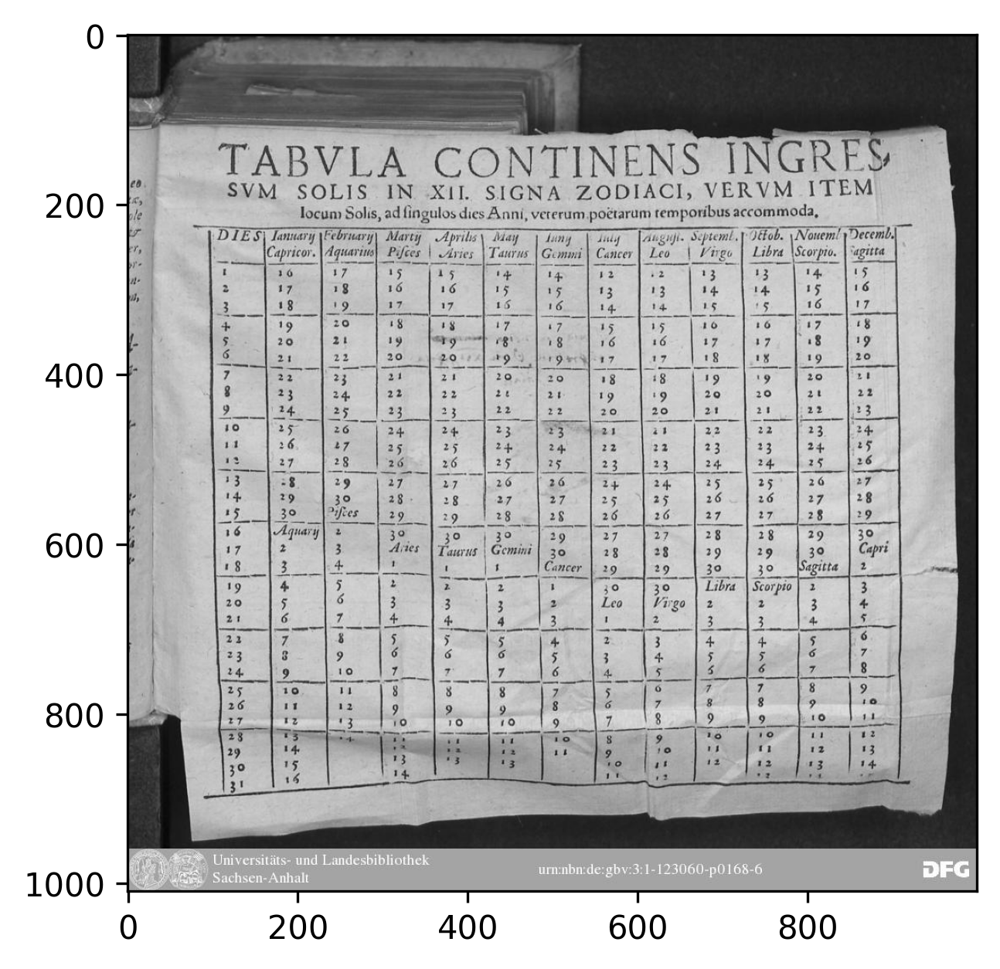

('2271_blebel_libellus_1577_p221', '/home/space/sphaera/sphaera_tables/processed/2271_blebel_libellus_1577_p221.jpg')


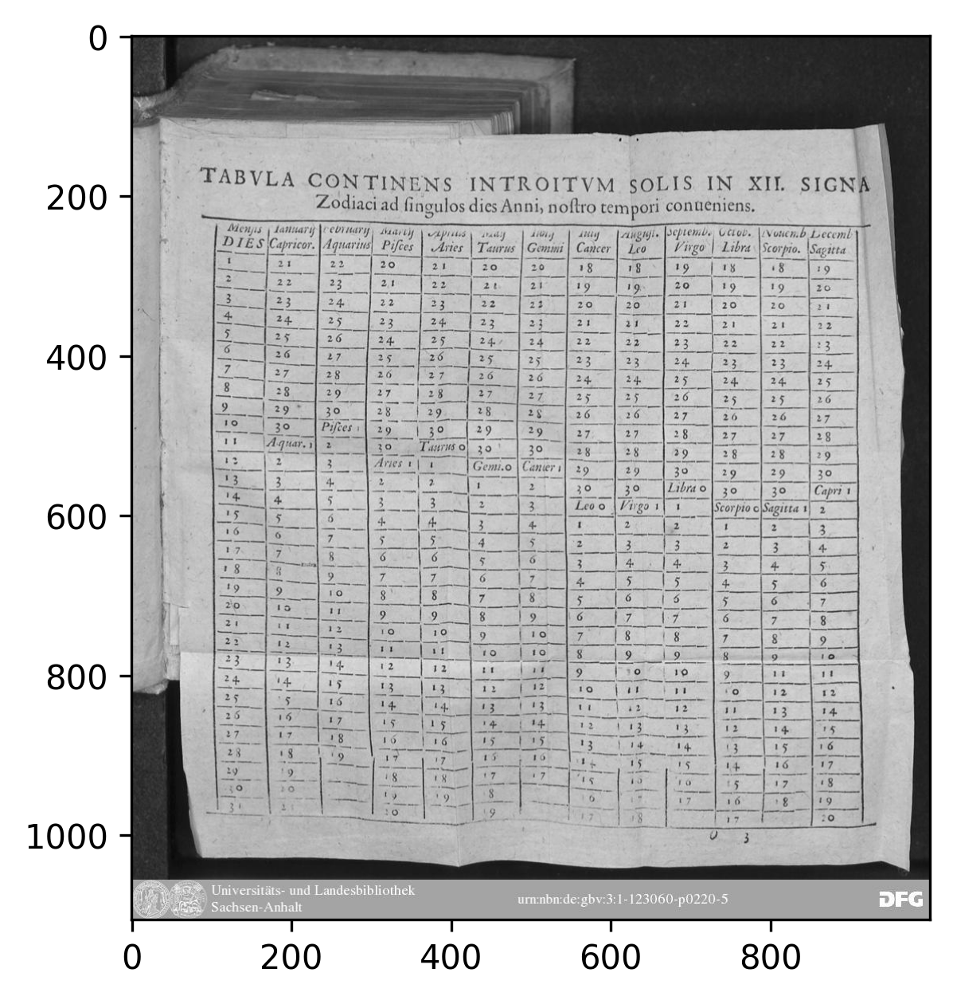

('1789_beyer_quaestiones_1569_p74', '/home/space/sphaera/sphaera_tables/processed/1789_beyer_quaestiones_1569_p74.jpg')


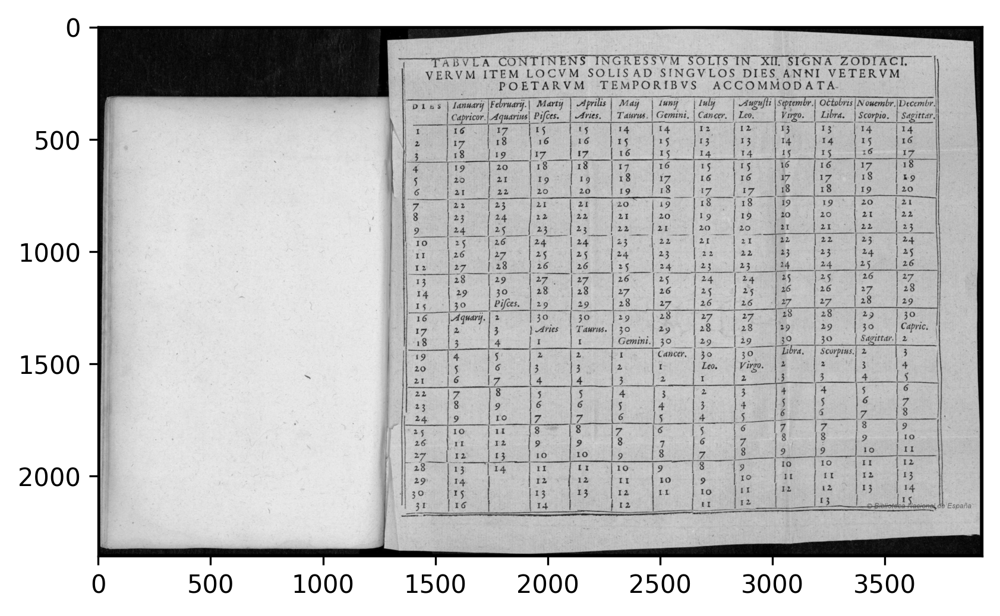

In [6]:
from evaluation.full_annotations import correlate_, get_gt_veterum_nostro
from evaluation.clustering import get_cluster_by_ref_page, get_gt_clusters

K=1500
seed=1
metric='euclidean'
cl_dict_dir = 'data/inference/cl_dict.p'
cl_dict = pickle.load(open(cl_dict_dir, 'rb'))
y_pred, _,_,_  = cl_dict[K]

res_pfile='data/inference/sphaera_hists.p'
H_all, M_all = get_data(res_pfile)

all_pages, years, books, books_unique,  book_dict = get_meta(M_all)

_, _, y_true_multi = get_gt_veterum_nostro(H_all, M_all, gt_csv ='data/corpus/sun_zodiac.csv')
y_1_2 = np.zeros_like(y_true_multi)
y_1_2[y_true_multi==1] = 1
y_1_2[y_true_multi==2] = 1


res = pickle.load(open(cl_dict_dir, 'rb'))  
y_pred = res[1500][0]

gt_pages = np.array(all_pages)[y_1_2==1]
detected_gt_clusters = get_gt_clusters(gt_pages, y_pred, all_pages)


# Select exaple cluster ids

cls = [359]

for cl in cls:
    print(cl)
    m = detected_gt_clusters[cl]
    for x in m:
        print(x)
        im = load_image(x[1].replace('processed', 'raw'))
        plt.figure(dpi=300)
        plt.imshow(im)
        plt.show()

# D. Corpus Exploration

<function plot_by_digit_density at 0x7fada3e849d0>


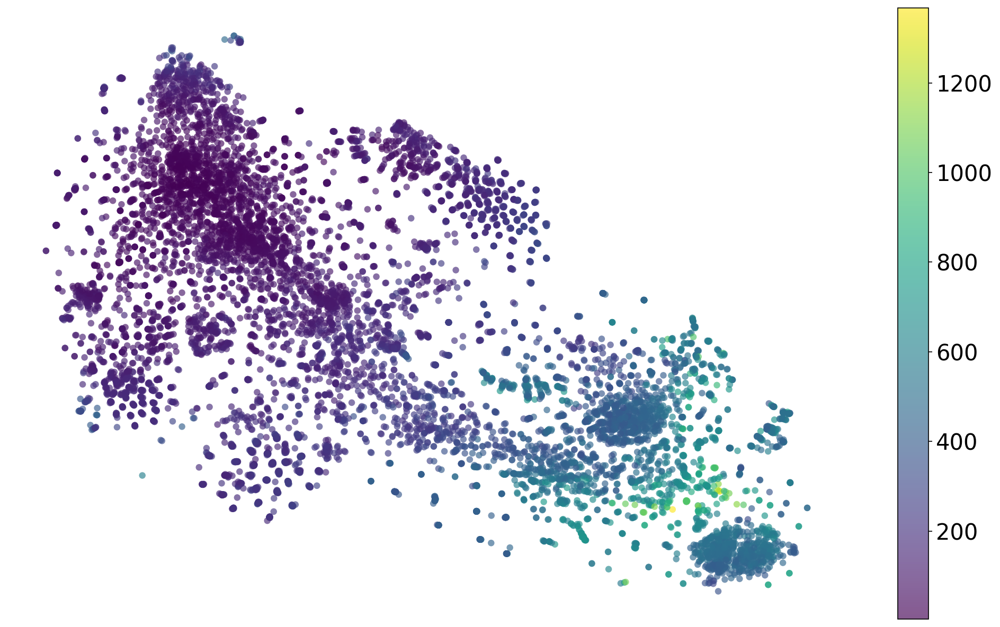

<function plot_by_cluster_size at 0x7fada3e84dc0>


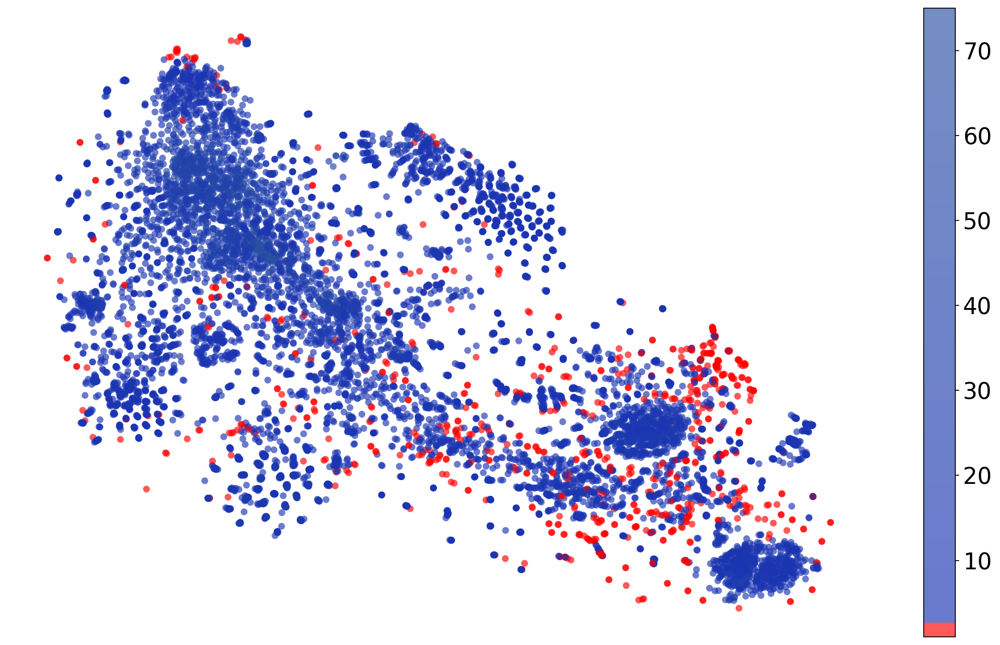

<function plot_by_year at 0x7fadf06324d0>


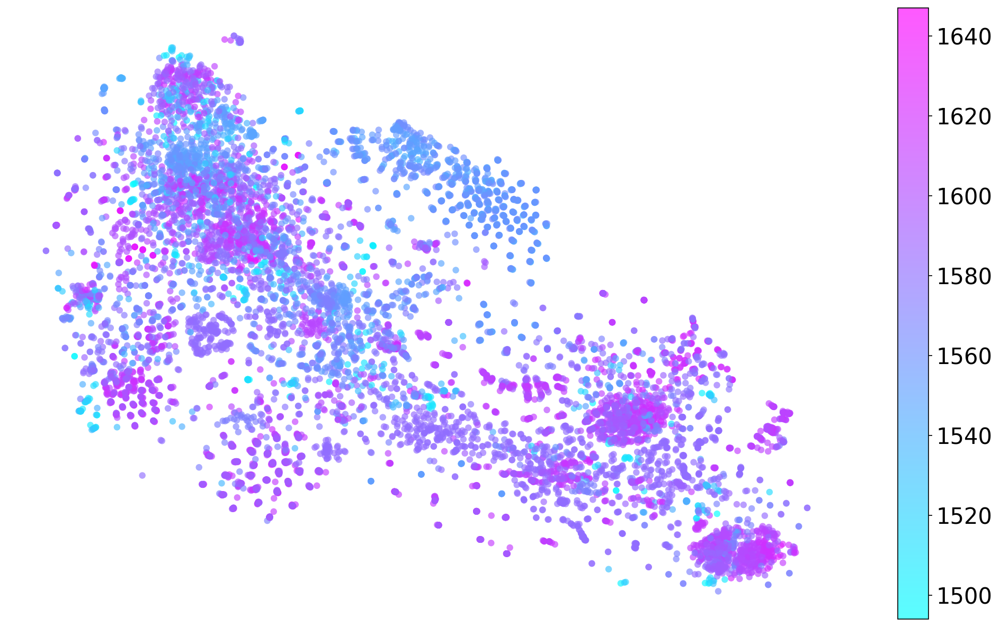

<function plot_by_book at 0x7fadf06328c0>


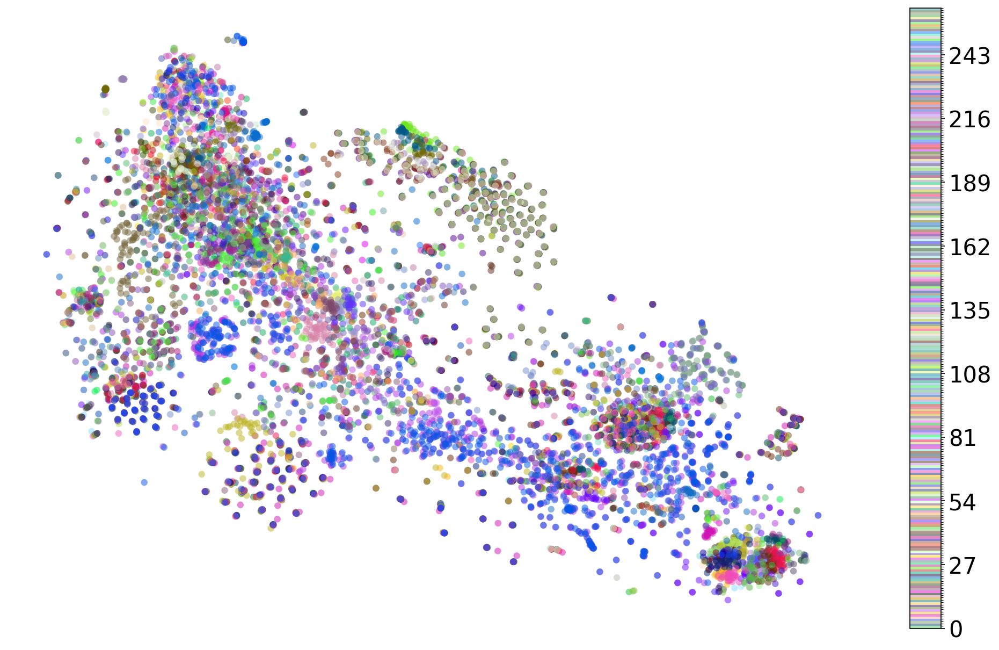

In [7]:
from plotting.plot_corpus import plot_by_year, plot_by_book, plot_by_digit_density, plot_by_cluster_size, plot_by_city

res_pfile='data/inference/sphaera_hists.p'
H_all, M_all = get_data(res_pfile, file_map = SACROBOSCO_DATA_ROOT)

K=1500
seed=1
metric='euclidean'
cl_dict_dir = 'data/inference/cl_dict.p'

bins_list= np.arange(1494, 1647+1)
cl_dict = pickle.load(open(cl_dict_dir, 'rb'))
y_pred, _,_,_  = cl_dict[K]

embed_dir = 'data/inference/embeds.p'
perplexity=500
X_embed = pickle.load(open(embed_dir, 'rb'))[perplexity]

plt.rc('legend',fontsize=25) 

kwargs = {'M':M_all, 'H':H_all, 'X_embed':X_embed, 'y_pred':y_pred}
for func in [plot_by_digit_density , plot_by_cluster_size, plot_by_year, plot_by_book]:
    f=plt.figure( figsize=(17,10), dpi=150)
    ax = plt.subplot(1, 1, 1)
    print(func)
    _ = func(fax=(f,ax), **kwargs)
    ax.axis('off')
    plt.show()